In [62]:
import nashpy as nash
import numpy as np
from itertools import permutations
import time
import math
import pandas as pd
from dataclasses import dataclass
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm
from adjustText import adjust_text


In [2]:
def generate_unique_distributions(N, M):
    """
    Generate all unique distributions of N identical soldiers into M armies,
    treating distributions that are permutations of each other as identical.
    Each distribution is sorted in non-decreasing order.
    """
    def backtrack(remaining, slots, current):
        if slots == 1:
            yield current + [remaining]
        else:
            for i in range(remaining + 1):
                yield from backtrack(remaining - i, slots - 1, current + [i])

    unique_distributions = set()
    for dist in backtrack(N, M, []):
        sorted_dist = tuple(sorted(dist))
        unique_distributions.add(sorted_dist)
    return sorted(unique_distributions)

In [3]:
def build_payoff_matrix(row_strategies, col_strategies):
    """
    Build the payoff matrix for the Blotto game.
    Payoff is from the row player's perspective and averaged over all permutations
    of the column player's strategy.
    """
    data = [(original_list, list(perm)) for original_list in col_strategies for perm in set(permutations(original_list))]
    permutation_df =  pd.DataFrame(data, columns=["Original List", "Permutation"])
    row_df = pd.DataFrame({'Row List': col_strategies})

    max_len = max(len(lst) for lst in permutation_df["Original List"])
    for i in range(max_len):
        permutation_df[f"Permutation_{i}"] = permutation_df["Permutation"].apply(lambda x: x[i] if i < len(x) else np.nan)
        row_df[f"Row_{i}"] = row_df["Row List"].apply(lambda x: x[i] if i < len(x) else np.nan)

    perm_cols = [f"Permutation_{i}" for i in range(max_len)]
    row_cols = [f"Row_{i}" for i in range(max_len)]

    combinations_df = pd.merge(permutation_df, row_df, how='cross')

    combinations_df['num_win'] = ((combinations_df[perm_cols].values - combinations_df[row_cols].values) > 0).sum(axis=1)
    combinations_df['num_lost'] = ((combinations_df[perm_cols].values - combinations_df[row_cols].values) < 0).sum(axis=1)
    combinations_df['result'] = combinations_df['num_win'] - combinations_df['num_lost']

    final_result = combinations_df.groupby(['Original List', 'Row List'])['result'].mean()
    final_result = final_result.unstack()
    return final_result

In [56]:
@dataclass
class resultInfo:
    n: int
    m: int
    num_strategies: int
    matrix_build_time: int
    solve_time: int

In [96]:
def timeRun(N, M):
    # Building matrix
    build_start = time.time()
    strategies = generate_unique_distributions(N, M)
    A = build_payoff_matrix(strategies, strategies)
    build_end = time.time()

    solve_start = time.time()
    game = nash.Game(A)
    p1, p2 = game.lemke_howson(0)
    solve_end = time.time()

    res = resultInfo(N, M, len(strategies),  build_end - build_start, solve_end - solve_start)


    print("# strategies:", len(strategies))
    print("N (basic):", math.comb(N+M-1, M-1))
    print("N (actual):", A.shape)
    print("Matrix creation:", build_end - build_start)
    print("Solving:", solve_end - solve_start)

    print("Row player:")
    for strat, prob in zip(strategies, p1):
        if prob > 0:
            print(strat, np.round(prob, decimals=4))

    print("Col player:")
    for strat, prob in zip(strategies, p2):
        if prob > 0:
            print(strat, np.round(prob, decimals=4))

    value = game[p1, p2]
    print("EVs:", value)
    print("-"*20)

    return res

In [97]:
timeRun(10, 3) 

/Users/akhilkammila/miniconda3/envs/probstat/lib/python3.11/site-packages/nashpy/linalg/tableau.py:380: RuntimeWarning: divide by zero encountered in divide
  row_ratios = self._tableau[:, column_index] / self._tableau[:, -1]
/Users/akhilkammila/miniconda3/envs/probstat/lib/python3.11/site-packages/nashpy/linalg/tableau.py:380: RuntimeWarning: divide by zero encountered in divide
  row_ratios = self._tableau[:, column_index] / self._tableau[:, -1]
/Users/akhilkammila/miniconda3/envs/probstat/lib/python3.11/site-packages/nashpy/linalg/tableau.py:380: RuntimeWarning: divide by zero encountered in divide
  row_ratios = self._tableau[:, column_index] / self._tableau[:, -1]
/Users/akhilkammila/miniconda3/envs/probstat/lib/python3.11/site-packages/nashpy/linalg/tableau.py:380: RuntimeWarning: divide by zero encountered in divide
  row_ratios = self._tableau[:, column_index] / self._tableau[:, -1]
/Users/akhilkammila/miniconda3/envs/probstat/lib/python3.11/site-packages/nashpy/linalg/tableau.

KeyboardInterrupt: 

In [91]:
results = []
soldiersDist = np.arange(1, 15, 1)
for soldiers in tqdm(soldiersDist):
    results.append(timeRun(soldiers, 3))

  0%|          | 0/14 [00:00<?, ?it/s]

100%|██████████| 14/14 [00:00<00:00, 175.83it/s]


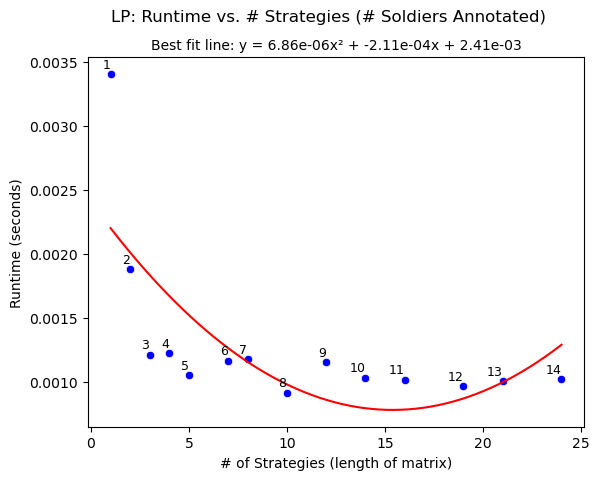

In [92]:
COLORS = sns.color_palette("pastel", 10)
plt.style.use('default')  # Reset to Matplotlib's default style
sns.reset_defaults()


timing_df = pd.DataFrame({
    'N': [res.n for res in results],
    'strategies': [res.num_strategies for res in results],
    'matrix_build_time': [res.matrix_build_time for res in results],
    'solve_time': [res.solve_time for res in results]
})

coeffs = np.polyfit(timing_df['strategies'], timing_df['solve_time'], deg=2)
x_smooth = np.linspace(min(timing_df['strategies']), max(timing_df['strategies']), 300)
y_smooth = np.polyval(coeffs, x_smooth)

fig, ax = plt.subplots()
sns.scatterplot(data=timing_df, x='strategies', y='solve_time', ax=ax, color='blue')
sns.lineplot(x=x_smooth, y=y_smooth, ax=ax, color='red')
texts = []
for i, row in timing_df.iterrows():
    texts.append(ax.text(row['strategies'], row['solve_time'], int(row['N']), fontsize=9, ha='right', va='bottom'))
adjust_text(texts, ax=ax, arrowprops=dict(arrowstyle='->', color='gray', lw=0.5))

plt.suptitle('LP: Runtime vs. # Strategies (# Soldiers Annotated)')
a, b, c = coeffs
equation = f"y = {a:.2e}x² + {b:.2e}x + {c:.2e}"
plt.title(f"Best fit line: {equation}", fontsize=10)
plt.xlabel('# of Strategies (length of matrix)')
plt.ylabel('Runtime (seconds)')

plt.show()

In [81]:
coeffs

array([ 9.08295460e-07, -2.55749715e-04,  1.92062752e-02])